### collectionを道路密度で分類する

In [1]:
import numpy as np
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from pathlib import Path
import multiprocessing
from scipy.spatial.distance import cdist
import yaml
from datetime import datetime

In [2]:
import simdkalman

def apply_kf_smoothing(df):
    logger.info('[START] Kalman Smoothing')
    # define kf model
    T = 1.0
    state_transition = np.array([[1, 0, T, 0, 0.5 * T ** 2, 0], [0, 1, 0, T, 0, 0.5 * T ** 2], [0, 0, 1, 0, T, 0],
                                [0, 0, 0, 1, 0, T], [0, 0, 0, 0, 1, 0], [0, 0, 0, 0, 0, 1]])
    process_noise = np.diag(
        [1e-5, 1e-5, 5e-6, 5e-6, 1e-6, 1e-6]) + np.ones((6, 6)) * 1e-9
    observation_model = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0]])
    observation_noise = np.diag([5e-5, 5e-5]) + np.ones((2, 2)) * 1e-9

    kf = simdkalman.KalmanFilter(
        state_transition=state_transition,
        process_noise=process_noise,
        observation_model=observation_model,
        observation_noise=observation_noise)

    unique_paths = df[['collectionName', 'phoneName']
                      ].drop_duplicates().to_numpy()
    for collection, phone in tqdm(unique_paths):
        cond = np.logical_and(df['collectionName'] ==
                              collection, df['phoneName'] == phone)
        data = df[cond][['latDeg', 'lngDeg']].to_numpy()
        data = data.reshape(1, len(data), 2)
        smoothed = kf.smooth(data)
        df.loc[cond, 'latDeg'] = smoothed.states.mean[0, :, 0]
        df.loc[cond, 'lngDeg'] = smoothed.states.mean[0, :, 1]
    return df

In [3]:

def linear_interpolation(input_df, speed_thr=45):
    logger.info('[START] linear interpolation')
    dfs = pd.DataFrame()
    use_col = input_df.columns
    for (collectionName, phoneName), df in input_df.groupby(['collectionName', 'phoneName']):

        df['delta'] = calc_haversine(
            df['latDeg'], df['lngDeg'], df['latDeg'].shift(1), df['lngDeg'].shift(1))
        df['time_delta'] = df['millisSinceGpsEpoch'] - \
            df['millisSinceGpsEpoch'].shift(1)
        df['delta'].fillna(0, inplace=True)
        df['time_delta'].fillna(0, inplace=True)
        df['speed'] = df['delta'] / (df['time_delta']/1000)  # m/s
        df['speed'].fillna(0, inplace=True)

        # 一度欠損値にする
        df.loc[speed_thr < df['speed'], ['latDeg', 'lngDeg']] = np.nan
        df['dummy_datetime'] = pd.to_datetime(df['millisSinceGpsEpoch'])
        df = df.set_index('dummy_datetime')

        # 時間に合わせて線形補間
        df = df.interpolate(method='time').reset_index(drop=True)
        dfs = pd.concat([dfs, df]).reset_index(drop=True)
    return dfs[use_col]

In [4]:
def make_lerp_data(df):
    '''
    Generate interpolated lat,lng values for different phone times in the same collection.
    '''
    org_columns = df.columns

    # Generate a combination of time x collection x phone and combine it with the original data (generate records to be interpolated)
    time_list = df[['collectionName', 'millisSinceGpsEpoch']].drop_duplicates()
    phone_list = df[['collectionName', 'phoneName']].drop_duplicates()
    tmp = time_list.merge(phone_list, on='collectionName', how='outer')

    lerp_df = tmp.merge(
        df, on=['collectionName', 'millisSinceGpsEpoch', 'phoneName'], how='left')

    lerp_df['phone'] = lerp_df['collectionName'] + '_' + lerp_df['phoneName']
    lerp_df = lerp_df.sort_values(['phone', 'millisSinceGpsEpoch'])

    # linear interpolation
    lerp_df['latDeg_prev'] = lerp_df['latDeg'].shift(1)
    lerp_df['latDeg_next'] = lerp_df['latDeg'].shift(-1)
    lerp_df['lngDeg_prev'] = lerp_df['lngDeg'].shift(1)
    lerp_df['lngDeg_next'] = lerp_df['lngDeg'].shift(-1)
    lerp_df['phone_prev'] = lerp_df['phone'].shift(1)
    lerp_df['phone_next'] = lerp_df['phone'].shift(-1)
    lerp_df['time_prev'] = lerp_df['millisSinceGpsEpoch'].shift(1)
    lerp_df['time_next'] = lerp_df['millisSinceGpsEpoch'].shift(-1)

    # Leave only records to be interpolated(missing coords data)
    lerp_df = lerp_df[(lerp_df['latDeg'].isnull()) & (lerp_df['phone'] == lerp_df['phone_prev']) & (
        lerp_df['phone'] == lerp_df['phone_next'])].copy()
    # calc lerp
    lerp_df['latDeg'] = lerp_df['latDeg_prev'] + ((lerp_df['latDeg_next'] - lerp_df['latDeg_prev']) * (
        (lerp_df['millisSinceGpsEpoch'] - lerp_df['time_prev']) / (lerp_df['time_next'] - lerp_df['time_prev'])))
    lerp_df['lngDeg'] = lerp_df['lngDeg_prev'] + ((lerp_df['lngDeg_next'] - lerp_df['lngDeg_prev']) * (
        (lerp_df['millisSinceGpsEpoch'] - lerp_df['time_prev']) / (lerp_df['time_next'] - lerp_df['time_prev'])))

    # Leave only the data that has a complete set of previous and next data.
    lerp_df = lerp_df[~lerp_df['latDeg'].isnull()]

    return lerp_df[org_columns]

def calc_mean_pred(df, lerp_df):
    '''
    Make a prediction based on the average of the predictions of phones in the same collection.
    '''
    add_lerp = pd.concat([df, lerp_df])
    mean_pred_result = add_lerp.groupby(['collectionName', 'millisSinceGpsEpoch'])[
        ['latDeg', 'lngDeg']].mean().reset_index()
    mean_pred_df = df.copy()
    mean_pred_df = mean_pred_df.drop(["latDeg", "lngDeg"], axis=1)
    mean_pred_df = mean_pred_df.merge(mean_pred_result[['collectionName', 'millisSinceGpsEpoch', 'latDeg', 'lngDeg']], on=[
                                      'collectionName', 'millisSinceGpsEpoch'], how='left')
    return mean_pred_df

def apply_mean(df):
    logger.info('[START] phone-mean')
    lerp = make_lerp_data(df)
    mean_df = calc_mean_pred(df, lerp)
    return mean_df

In [5]:
def get_removedevice(input_df: pd.DataFrame, device: str) -> pd.DataFrame:
    logger.info('[START] remove device')
    input_df['index'] = input_df.index
    input_df = input_df.sort_values('millisSinceGpsEpoch')
    input_df.index = input_df['millisSinceGpsEpoch'].values

    output_df = pd.DataFrame()
    for _, subdf in input_df.groupby('collectionName'):

        phones = subdf['phoneName'].unique()

        if (len(phones) == 1) or (not device in phones):
            output_df = pd.concat([output_df, subdf])
            continue

        origin_df = subdf.copy()

        _index = subdf['phoneName'] == device
        subdf.loc[_index, 'latDeg'] = np.nan
        subdf.loc[_index, 'lngDeg'] = np.nan
        subdf = subdf.interpolate(method='index', limit_area='inside')

        _index = subdf['latDeg'].isnull()
        subdf.loc[_index, 'latDeg'] = origin_df.loc[_index, 'latDeg'].values
        subdf.loc[_index, 'lngDeg'] = origin_df.loc[_index, 'lngDeg'].values

        output_df = pd.concat([output_df, subdf])

    output_df.index = output_df['index'].values
    output_df = output_df.sort_index()

    del output_df['index']

    return output_df

In [6]:
def init_logger(log_file='logger.log'):
    from logging import getLogger, INFO, FileHandler,  Formatter,  StreamHandler
    logger = getLogger(__name__)
    logger.setLevel(INFO)
    handler1 = StreamHandler()
    handler1.setFormatter(Formatter("%(message)s"))
    handler2 = FileHandler(filename=log_file)
    handler2.setFormatter(Formatter("%(message)s"))
    logger.addHandler(handler1)
    logger.addHandler(handler2)
    return logger
    
today = datetime.now().strftime('%Y-%m-%d')
logger = init_logger(log_file=f'./{today}.log')
logger.info('Start Logging...')

Start Logging...


In [7]:
# metric
def calc_haversine(lat1, lon1, lat2, lon2):
    """Calculates the great circle distance between two points
    on the earth. Inputs are array-like and specified in decimal degrees.
    """
    RADIUS = 6_367_000
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + \
        np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    dist = 2 * RADIUS * np.arcsin(a**0.5)
    return dist

def check_score(input_df: pd.DataFrame) -> pd.DataFrame:
    if "phone" not in input_df.columns:
        input_df["phone"] = input_df["collectionName"] + "_" + input_df["phoneName"]

    if "target_latDeg" not in input_df.columns:
        processes = multiprocessing.cpu_count()
        with multiprocessing.Pool(processes=processes) as pool:
            gr = input_df.groupby(['collectionName','phoneName'])
            dfs = pool.imap_unordered(get_ground_truth, gr)
            dfs = tqdm(dfs, total=len(gr))
            dfs = list(dfs)
        input_df = pd.concat(dfs).sort_values(['collectionName', 'phoneName', 'millisSinceGpsEpoch']).reset_index(drop=True)     


    output_df = input_df.copy()
    
    output_df['error'] = input_df.apply(
        lambda r: calc_haversine(
            r.latDeg, r.lngDeg, r.target_latDeg, r.target_lngDeg
        ),
        axis=1
    )

    meter_score = output_df['error'].mean()
    logger.info(f'mean error: {meter_score}')

    scores = []
    p_50_scores = []
    p_95_scores = []
    mean_scores = []
    phones = []
    score_df = pd.DataFrame()
    for phone in output_df['phone'].unique():
        _index = output_df['phone']==phone
        p_50 = np.percentile(output_df.loc[_index, 'error'], 50)
        p_95 = np.percentile(output_df.loc[_index, 'error'], 95)
        # print(f"{phone} | 50:{p_50:.5g}| 95:{p_95:.5g}")
        p_50_scores.append(p_50)
        p_95_scores.append(p_95)
        mean_scores.append(np.mean([p_50, p_95]))
        phones.append(phone)

        scores.append(p_50)
        scores.append(p_95)

    score_df["phone"] = phones
    score_df["p_50_score"] = p_50_scores
    score_df["p_95_score"] = p_95_scores
    score_df["mean_score"] = mean_scores
    
    comp_score = sum(scores) / len(scores)
    logger.info(f"competition metric:{comp_score}")
    return output_df, score_df

In [8]:
import warnings
warnings.simplefilter('ignore')
# waypointを補正したdataset
root_dir = Path('../../input/google-smartphone-decimeter-challenge')
train_df = pd.read_csv(root_dir / "baseline_locations_train_with_speed.csv")
train_df = linear_interpolation(train_df)
train_df = apply_kf_smoothing(train_df)
train_df = apply_mean(train_df)
train_df = get_removedevice(train_df, 'SamsungS20Ultra')

[START] linear interpolation
[START] Kalman Smoothing


  0%|          | 0/73 [00:00<?, ?it/s]

[START] phone-mean
[START] remove device


In [10]:
from shapely.geometry import Polygon
import geopandas as gpd
from functools import partial
import pyproj
from shapely.ops import transform

def geom_to_area(geom, epsg=3410): # epsg=3410：正積図法
    project = partial( # 関数の入力を部分的に与える．
        pyproj.transform, 
        pyproj.CRS.from_epsg(4326), # WGS84      # ver 2.2.x
        pyproj.CRS.from_epsg(epsg))              # ver 2.2.x
    trans = transform(project, geom) # 座標系変換
    return trans.area # 面積を返す


def Swap_xy(geom):
    # (x, y) -> (y, x)
    def swap_xy_coords(coords):
        for x, y in coords:
            yield (y, x)

    # if geom.type == 'Polygon':
    def swap_polygon(geom):
        ring = geom.exterior
        shell = type(ring)(list(swap_xy_coords(ring.coords)))
        holes = list(geom.interiors)
        for pos, ring in enumerate(holes):
            holes[pos] = type(ring)(list(swap_xy_coords(ring.coords)))
        return type(geom)(shell, holes)

    # if geom.type == 'MultiPolygon':
    def swap_multipolygon(geom):
        return type(geom)([swap_polygon(part) for part in geom.geoms])

    # Main
    if geom.type == 'Polygon':
        return swap_polygon(geom)
    elif geom.type == 'MultiPolygon':
        return swap_multipolygon(geom)
    else:
        raise TypeError('Unexpected geom.type:', geom.type)

def CalcArea(geom):
    geom_swap = Swap_xy(geom)
    area = geom_to_area(geom_swap)
    return area * 1e-6 # m2 -> km2 

In [90]:
from shapely.geometry import Point
import osmnx as ox
import momepy
import geopandas as gpd
from shapely.ops import nearest_points

def extract_road_data(args):
    collection_name, points = args
    ################
    # read load data
    ################
    points["geometry"] = [Point(p) for p in points[["lngDeg", "latDeg"]].to_numpy()]
    points = gpd.GeoDataFrame(points, geometry=points["geometry"])
    offset = 0.1**3
    bbox = points.bounds + [-offset, -offset, offset, offset]
    east = bbox["minx"].min()
    west = bbox["maxx"].max()
    south = bbox["miny"].min()
    north = bbox["maxy"].max()
    G = ox.graph.graph_from_bbox(north, south, east, west, network_type='drive')
    _, lines = momepy.nx_to_gdf(G)
    lines = lines.dropna(subset=["geometry"]).reset_index(drop=True)
    hits = bbox.apply(lambda row: list(lines.sindex.intersection(row)), axis=1)
    tmp = pd.DataFrame({
        # index of points table
        "pt_idx": np.repeat(hits.index, hits.apply(len)),
        # ordinal position of line - access via iloc later
        "line_i": np.concatenate(hits.values)
    })
    # Join back to the lines on line_i; we use reset_index() to 
    # give us the ordinal position of each line
    tmp = tmp.join(lines.reset_index(drop=True), on="line_i")
    # Join back to the original points to get their geometry
    # rename the point geometry as "point"
    tmp = tmp.join(points.geometry.rename("point"), on="pt_idx")
    # Convert back to a GeoDataFrame, so we can do spatial ops
    tmp = gpd.GeoDataFrame(tmp, geometry="geometry", crs=points.crs)

    ####################
    # Find closest line
    ###################
    tmp["snap_dist"] = tmp.geometry.distance(gpd.GeoSeries(tmp.point))

    # Discard any lines that are greater than tolerance from points
    tolerance = 0.0005
    tmp = tmp.loc[tmp.snap_dist <= tolerance]
    # Sort on ascending snap distance, so that closest goes to top
    tmp = tmp.sort_values(by=["snap_dist"])

    # group by the index of the points and take the first, which is the
    # closest line 
    closest = tmp.groupby("pt_idx").first()
    # construct a GeoDataFrame of the closest lines
    closest = gpd.GeoDataFrame(closest, geometry="geometry")
    closest = closest.drop_duplicates("line_i").reset_index(drop=True)

    closest['area_km'] = CalcArea(Polygon([(east, north),(west, north), (west, south), (east, south)]))  # km

    closest.drop(['point','snap_dist'], axis=1, inplace=True)
    closest['collectionName'] = collection_name
    return closest

In [91]:
import multiprocessing
processes = multiprocessing.cpu_count()
gr = train_df.groupby("collectionName")
with multiprocessing.Pool(processes=processes) as pool:
    dfs = pool.imap_unordered(extract_road_data, gr)
    dfs = tqdm(dfs, total=len(gr))
    dfs = list(dfs)
road_df = pd.concat(dfs)

  0%|          | 0/29 [00:00<?, ?it/s]

In [96]:
train_df['geometry'] = [Point(lng, lat) for lng, lat in train_df[['lngDeg', 'latDeg']].values]
_train_df = gpd.GeoDataFrame(train_df, geometry='geometry')

In [97]:
m = folium.Map(location=[37.423576,-122.094132], iles='openstreetmap', zoom_start=11)
    
# コロプレス図の追加
folium.GeoJson(
    data=road_df[['geometry', 'collectionName']].to_json(),
    style_function=lambda feature: {
        'fillColor': None,
        'color': 'green',
        # 'weight': 2,
        # 'fill_opacity': 0.6,
        # 'line_opacity': 0.2,
    },
    tooltip=folium.features.GeoJsonTooltip(
    fields=['collectionName'],
    aliases=['collectionName'],
    localize=True
    ),

    name='road line',
    show=True
        ).add_to(m)

folium.GeoJson(
    data=_train_df[['geometry', 'collectionName']].to_json(),
    style_function=lambda feature: {
        'fillColor': None,
        'color': 'blue',
        # 'weight': 2,
        # 'fill_opacity': 0.6,
        # 'line_opacity': 0.2,
    },
    tooltip=folium.features.GeoJsonTooltip(
    fields=['collectionName'],
    aliases=['collectionName'],
    localize=True
    ),

    name='train grid',
    show=True
        ).add_to(m)

folium.LayerControl(collapsed=False).add_to(m)
m

In [74]:
# road_df['_highway'] = [i[0] if (type(i)==list)&(in i) else i for i in road_df['highway'].to_numpy()]

In [80]:
# import folium
# import folium.plugins
# import branca
# import branca.colormap as cm
# from sklearn import preprocessing

# def make_linear(gdf, column, linear_min=0.0, linear_max=0.0):
#     linear_min = max(linear_min, gdf[column].min())
#     linear_max = max(linear_max, gdf[column].max())
#     linear_length = len(gdf[column].dropna().unique())
#     linear = cm.linear.YlGnBu_09.scale(linear_min, linear_max).to_step(linear_length)
#     linear.caption = column
#     return linear

# use_col = [
#     # 'lanes',
#     # 'name', 
#     'highway',
#     # 'maxspeed',
#     # 'length',
#     # 'bridge', 
#     # 'tunnel',
#     # 'junction',
#     # 'access'
#            ]

# m = folium.Map(location=[37.423576,-122.094132], iles='openstreetmap', zoom_start=11)
# for column in use_col:
#     print(column)
#     le = preprocessing.LabelEncoder()
#     closest[f'le_{column}'] = le.fit_transform(closest[column])
#     linear = make_linear(closest, column=f"le_{column}")
    
#     # コロプレス図の追加
#     folium.GeoJson(
#         data=closest[['geometry', f"le_{column}"]].to_json(),
#         style_function=lambda feature: {
#             'fillColor': None,
#             'color': linear(feature['properties'][f"le_{column}"]),
#             # 'weight': 2,
#             # 'fill_opacity': 0.6,
#             # 'line_opacity': 0.2,
#         },
#         tooltip=folium.features.GeoJsonTooltip(
#         fields=[f'le_{column}'],
#         aliases=[column],
#         localize=True
#         ),

#         name=column,
#         show=True
#             ).add_to(m)
# folium.LayerControl(collapsed=False).add_to(m)
# m

highway


In [77]:
closest['highway'].value_counts()

motorway_link    53
motorway         47
secondary         7
primary           5
tertiary          5
unclassified      3
residential       2
Name: highway, dtype: int64

In [78]:
closest['le_highway'].value_counts()

1    53
0    47
4     7
2     5
5     5
6     3
3     2
Name: le_highway, dtype: int64

<AxesSubplot:>

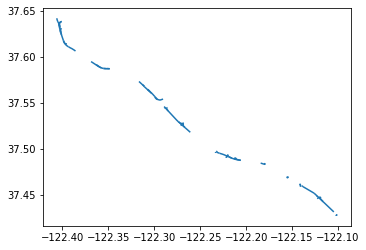

In [22]:
closest.plot(column="bridge")